In [1]:
# %run ../imports.ipynb
from tqdm.auto import tqdm
import plotly.express as px
from IPython.core.display import display, HTML
import pandas as pd
import time
import warnings
from requests import get
from ratelimit import limits
import numpy as np
import itertools
pd.set_option('max_columns',1000)

class RequestLimiter:
    """Utility to block if we are making too many requests"""
    def __init__(self, max_requests=49, time_interval=60):
        """
        max_requests: max requests that can be made in time_interval
        time_interval: time interval in seconds
        """
        self.max_requests = max_requests
        self.time_interval = time_interval
        self.arr = np.ones(max_requests) * np.nan
        self.cyclic_idx = itertools.cycle(range(0, max_requests))
        
    def request(self):
        """Call this each time a request is made.  Will block if necessary"""
        while True:
            # if all of the requests have been within the last time_interval, wait
            n_requests_in_time_interval = (self.arr > time.time() - self.time_interval).sum()
            if n_requests_in_time_interval < self.max_requests:
                break
        
        # record the time in the cyclic index in the array
        self.arr[next(self.cyclic_idx)] = time.time()
        
LIMITER = RequestLimiter()  

def get2(url, params=None, **kwargs):
    """Wraper around request.get which uses LIMITER"""
    return get(url)

# Get main identifiers

In [2]:
# if you get an exception, you've probably hit max requests.  just wait a minute and re-run.
df_coins = pd.DataFrame(get2('https://api.coingecko.com/api/v3/coins/list').json())
df_exchanges_all = pd.DataFrame(get2('https://api.coingecko.com/api/v3/exchanges/list').json())
df_exchanges = pd.DataFrame(get2('https://api.coingecko.com/api/v3/exchanges').json())
top10_exchanges = df_exchanges.id.tolist()[:10]

# Get individual exchange data
Probably would need to do this on a cron job

In [3]:
def get_all_pages(url, max_pages=None, backoff='wait', **params):
    """Deals with coingecko pagination"""
    i=1
    data = []
    with tqdm() as t:
        while True:         
            LIMITER.request()                            
            resp = get(url, dict(page=i, **params))
            
            # Handle invalid status_codes
            if resp.status_code == 429:
                # status: too many requests
                if backoff == 'wait':
                    print('had to back off, we should reduce the number '
                          'of requests or use a global variable to throttle...')
                    time.sleep(30)
                    continue
                elif backoff == 'stop':
                    break
            elif resp.status_code != 200:
                raise Exception(f'{resp.status_code} {resp.reason}')
    
             # status: OK
            x = resp.json()  
            if 'tickers' in x:
                # exchanges/binance/tickers endpoint returns {'name':'exchange', 'tickers':[...]} for some reason
                x = x['tickers']                

            if len(x) == 0:
                # no pages left in the data
                break                
            else:
                data += x
                i+=1
                t.update()

            if max_pages and i>=max_pages:
                break
                
    return data
        
# coin_ids parameter looks broken!  wish we could filter by ETH to speed things up, but nbd  
df_binance = pd.DataFrame(get_all_pages('https://api.coingecko.com/api/v3/exchanges/binance/tickers',
                                        max_pages=None, backoff='wait'))

0it [00:00, ?it/s]

In [4]:
# coin_ids parameter looks broken!  wish we could filter by ETH to speed things up, but nbd  
df_uniswap = pd.DataFrame(get_all_pages('https://api.coingecko.com/api/v3/exchanges/uniswap/tickers',
                                        max_pages=None, backoff='wait'))

0it [00:00, ?it/s]

In [5]:
df_coin_markets = pd.DataFrame(get_all_pages('https://api.coingecko.com/api/v3/coins/markets',
                                             max_pages=None, backoff='wait', per_page=250, vs_currency='USD',price_change_percentage="1h,24h,7d,14d,30d,200d,1y"))
df_coin_markets = df_coin_markets.set_index('id', drop=False)

0it [00:00, ?it/s]

# Filter Coins

In [6]:
t = df_uniswap[(df_uniswap.base == 'ETH') | (df_uniswap.target == 'ETH')]
uniswap_coins = set(t.coin_id).union(t.target_coin_id)

binance_coins = set(df_binance.coin_id).union(df_binance.target_coin_id)

uniswap_only_coin_ids = uniswap_coins - binance_coins

In [222]:
z = df_coin_markets.loc[df_coin_markets.index.isin(uniswap_only_coin_ids)].copy()
z['vol_div_market_cap'] = z.total_volume / z['market_cap']
z = z.loc[(z.market_cap > 1e6) & (z.market_cap < 1e9) & (z.vol_div_market_cap > .05)]
df_coins = z
len(df_coins)

338

# Download coin prices

In [8]:
import datetime
def get_prices(coin_id, from_time=None, to_time=None):
    """Get historical prices for coin_id"""
    LIMITER.request()
    # we keep to_time as a parameter so that we can m

    if from_time is None:
        from_time = int(datetime.datetime(2015, 1, 1, 0, 0, 0).timestamp())
    if to_time is None:
        to_time = int(datetime.datetime.now().timestamp())
    z = get(f'https://api.coingecko.com/api/v3/coins/{coin_id}/market_chart/range',
            params={'vs_currency':'usd','from':from_time,'to':to_time})
    df_price = pd.concat([pd.DataFrame(v, columns=['time',k]).set_index('time') for k,v in z.json().items()], axis=1).reset_index()
    df_price.market_caps.replace(0.0, np.nan, inplace=True)
    # convert to pandas Timestamp
    df_price['time'] = df_price.time.map(lambda x: pd.Timestamp.fromtimestamp(x/1000))
    df_price['price_pct_change'] = (df_price['prices'] / df_price['prices'].iloc[0] - 1) * 100
    df_price['vol_over_market_cap'] = df_price['total_volumes'] / df_price['market_caps']
    
    df_price
    
    df_price.insert(1, 'coin_id',  coin_id)
    return df_price

df_bitcoin = get_prices('bitcoin')
df_eth = get_prices('ethereum')
df_prices = pd.concat([get_prices(coin_id) for coin_id in tqdm(set(z.id))])


  0%|          | 0/30 [00:00<?, ?it/s]

## Add some extra fields to df_coins

In [9]:
df_coins['market_cap_start'] = df_prices.groupby('coin_id').apply(lambda t: t[t.market_caps>10.0].time.iloc[0])
df_coins = df_coins.sort_values('market_cap_start', ascending=False) # put newest coins first
df_coins_ = df_coins[df_coins.market_cap_start > '20211001'] # filter for new coins

In [19]:
## links

def link(coin_id):
    return f"""<a href="https://www.coingecko.com/en/coins/{coin_id}/">{coin_id}</a>"""
    
display(HTML(" | ".join(link(coin_id) for coin_id in df_coins_.index)))

# Plot coins

In [83]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

coin_id = 'neos-credits'

fig = make_subplots(
    rows=5, cols=1,

#     subplot_titles=("BTC/ETH","Price Pct Change","Volume", "Vol/MarketCap"),
    shared_xaxes=True,
row_heights=[4,8,2,2,2],

)
fig.update_layout(dict(height=700))


z = df_prices[df_prices.coin_id == coin_id]
df_bitcoin_=df_bitcoin.set_index('time').loc[z.time]
df_eth_=df_eth.set_index('time').loc[z.time]
fig.add_trace(go.Scatter(x=df_bitcoin_.index, y=df_bitcoin_.market_caps, name='btc'), row=1, col=1)
fig.add_trace(go.Scatter(x=df_eth_.index, y=df_eth_.market_caps, name='eth'), row=1, col=1)
fig.add_trace(go.Scatter(x=z.time, y=z.price_pct_change, name='price_pct_change'), row=2, col=1)
fig.add_trace(go.Scatter(x=z.time, y=z.total_volumes, name='volume'), row=3, col=1)
fig.add_trace(go.Scatter(x=z.time, y=z.vol_over_market_cap, name='vol/market_cap'), row=4, col=1)
fig.add_trace(go.Scatter(x=z.time, y=z.market_caps, name='market_cap'), row=5, col=1)


# Get Coin Categories

In [3]:
import requests
import pickle


In [460]:
df_coin_markets[df_coin_markets.id.str.contains('neos')]

,id,symbol,name,image,current_price,market_cap,market_cap_rank,fully_diluted_valuation,total_volume,high_24h,low_24h,price_change_24h,price_change_percentage_24h,market_cap_change_24h,market_cap_change_percentage_24h,circulating_supply,total_supply,max_supply,ath,ath_change_percentage,ath_date,atl,atl_change_percentage,atl_date,roi,last_updated,price_change_percentage_14d_in_currency,price_change_percentage_1h_in_currency,price_change_percentage_1y_in_currency,price_change_percentage_200d_in_currency,price_change_percentage_24h_in_currency,price_change_percentage_30d_in_currency,price_change_percentage_7d_in_currency
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
neos-credits,neos-credits,ncr,Neos Credits,https://assets.coingecko.com/coins/images/1793...,5.04,199674903.0,325.0,253211941.0,5719944.0,5.55,4.56,-0.506968,-9.13281,-2.096349e+07,-9.50129,3.942841e+07,50000000.0,50000000.0,9.42,-46.25942,2021-11-29T07:09:49.146Z,0.177769,2748.7677,2021-08-25T17:11:04.154Z,None,2021-12-08T20:04:41.368Z,87.550908,-1.111337,NaN,NaN,-9.132807,1070.544973,-28.007368


In [473]:
binance_coins_ncr=list(binance_coins)
binance_coins_ncr.append('neos-credits')
binance_coins_ncr.pop(0)

nan

In [475]:
df_coins = df_coin_markets.loc[df_coin_markets.index.isin(binance_coins_ncr )].copy()


In [484]:
#df_prices = pd.concat([get_prices(coin_id) for coin_id in tqdm(set(df_coins.id))])


In [486]:
df_prices=pd.concat([df_prices,get_prices('neos-credits')])

In [490]:
def get_coin_cats(coin):
    time.sleep(1)
    return requests.get("https://api.coingecko.com/api/v3/coins/{}".format(coin)).json()['categories']

In [491]:
cat_map={}
for c in tqdm(df_prices.coin_id.unique().tolist()):
    cat_map[c]=get_coin_cats(c)


  0%|          | 0/347 [00:00<?, ?it/s]

In [492]:
with open('catmap.pickle', 'wb') as handle:
    pickle.dump(cat_map, handle, protocol=pickle.HIGHEST_PROTOCOL)



In [4]:
with open('catmap.pickle', 'rb') as handle:
    cat_map = pickle.load(handle)

In [494]:
with open('df_prices.pickle', 'wb') as handle:
    pickle.dump(df_prices, handle, protocol=pickle.HIGHEST_PROTOCOL)



In [5]:
with open('df_prices.pickle', 'rb') as handle:
    df_prices = pickle.load(handle)

In [6]:
df_prices_jul=df_prices[df_prices.time>='20210701']

In [7]:
def get_jul_pct_chg_price(df, coin):
    new_df=df[df.coin_id==coin].sort_values('time')[['time','coin_id','prices']]
    new_df['pct_change_price']=new_df.groupby('coin_id')['prices'].apply(lambda x: x.div(x.iloc[0]).subtract(1).mul(100))
    return new_df

In [8]:
def get_jul_pct_chg_mc(df, coin):
    new_df=df[df.coin_id==coin].sort_values('time')[['time','coin_id','market_caps']]
    new_df['pct_change_market_cap']=new_df.groupby('coin_id')['market_caps'].apply(lambda x: x.div(x.iloc[0]).subtract(1).mul(100))
    return new_df

In [9]:
df_prices_jul.shape

(55349, 7)

In [10]:
df_prices_jul1=df_prices_jul
df_prices_jul1['tag']=df_prices_jul1['coin_id'].map(cat_map)
df_prices_jul1=df_prices_jul1.explode('tag')

/tmp/ipykernel_14664/2137245538.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_prices_jul1['tag']=df_prices_jul1['coin_id'].map(cat_map)


In [11]:
df_meta_jul=df_prices_jul1[df_prices_jul1.tag=='Metaverse']
meta_l_mc=[]
for c in df_prices.coin_id.unique().tolist():
    meta_l_mc.append(get_jul_pct_chg_mc(df_meta_jul,c))

meta_l_p=[]
for c in df_prices.coin_id.unique().tolist():
    meta_l_p.append(get_jul_pct_chg_price(df_meta_jul,c))


In [12]:
df_meta_p=pd.concat(meta_l_p).drop_duplicates().sort_values(['coin_id','time'])
df_meta_mc=pd.concat(meta_l_mc).drop_duplicates().sort_values(['coin_id','time'])


In [13]:
fig = px.line(df_meta_p, x='time', y='pct_change_price',
              color="coin_id",
              line_group="coin_id", hover_name="coin_id")
fig.update_layout(title='ncr vs metaverse- is duffy useful (price)' , showlegend=True, legend_traceorder='normal')

fig2 = px.line(df_meta_mc, x='time', y='pct_change_market_cap',
              color="coin_id",
              line_group="coin_id", hover_name="coin_id")
fig2.update_layout(title='is duffy useful (market cap)' , showlegend=True, legend_traceorder='normal')
fig.show()
fig2.show()


In [14]:
cdf_l=[]
for c in df_prices.coin_id.unique().tolist():
    cdf_l.append(get_jul_pct_chg_price(df_prices_jul,c))

In [15]:
cdf_l1=[]
for c in df_prices.coin_id.unique().tolist():
    cdf_l1.append(get_jul_pct_chg_mc(df_prices_jul,c))

In [16]:
df_pct_jul_p=pd.concat(cdf_l).drop_duplicates().sort_values(['coin_id','time'])
df_pct_jul_p['tag']=df_pct_jul_p['coin_id'].map(cat_map)
df_pct_jul_p=df_pct_jul_p.explode('tag')

In [17]:
df_pct_jul_mc=pd.concat(cdf_l1).drop_duplicates().sort_values(['coin_id','time'])
df_pct_jul_mc['tag']=df_pct_jul_mc['coin_id'].map(cat_map)
df_pct_jul_mc=df_pct_jul_mc.explode('tag')

In [18]:

df_med_pct_p=df_pct_jul_p.groupby(['time','tag'])['pct_change_price'].median().reset_index()
df_med_pct_mc=df_pct_jul_mc.groupby(['time','tag'])['pct_change_market_cap'].median().reset_index()



In [19]:
fig = px.line(df_med_pct_p, x='time', y='pct_change_price',
              color="tag",
              line_group="tag", hover_name="tag")
fig.update_layout(title='pct_change_price since july' , showlegend=True, legend_traceorder='normal')

fig2 = px.line(df_med_pct_mc, x='time', y='pct_change_market_cap',
              color="tag",
              line_group="tag", hover_name="tag")
fig2.update_layout(title='pct_change_market_cap since july' , showlegend=True, legend_traceorder='normal')
fig.show()
fig2.show()


In [20]:
df_prices['tag']=df_prices['coin_id'].map(cat_map)
df_prices_tags=df_prices.explode('tag')

In [21]:
time_tag_price_agg=df_prices_tags.groupby(['time','tag'])['prices'].sum().reset_index()

In [22]:
time_tag_price_agg=time_tag_price_agg[~((time_tag_price_agg.time=='2018-01-15 19:00:00')&(time_tag_price_agg.tag=='Non-Fungible Tokens (NFT)'))]

In [23]:
time_tag_mc_agg=df_prices_tags.groupby(['time','tag'])['market_caps'].sum().reset_index()

In [24]:
time_tag_mc_agg=time_tag_mc_agg[~((time_tag_mc_agg.time=='2018-01-15 19:00:00')&(time_tag_mc_agg.tag=='Non-Fungible Tokens (NFT)'))]

In [25]:
fig = px.line(time_tag_price_agg, x='time', y='prices',
              color="tag",
              line_group="tag", hover_name="tag")
fig.update_layout(title='Price' , showlegend=True, legend_traceorder='normal')

fig2 = px.line(time_tag_mc_agg, x='time', y='market_caps',
              color="tag",
              line_group="tag", hover_name="tag")
fig2.update_layout(title='market_caps' , showlegend=True, legend_traceorder='normal')
fig.show()
fig2.show()


## Fit simple curves
#### Try a couple of different windows for SMA, fit poly, calculate R2

In [17]:
import pandas
import pandas as pd
import os
import re
import json
from dataclasses import dataclass
import joblib
import numpy
import datetime
import importlib
import numpy
from IPython import display
from matplotlib import pyplot as plt
import numpy as np
from datetime import timedelta
np = numpy
pd = pandas
%load_ext autoreload
%autoreload 2
%matplotlib inline
# %load_ext autotime

import logging
logging.basicConfig(level=logging.INFO)
#%run ../imports.ipynb
from tqdm.auto import tqdm
import plotly.express as px
import seaborn as sns
from IPython.core.display import display, HTML

pd.set_option('max_columns',1000)


In [142]:
import scipy
import matplotlib.dates as dates
import datetime, calendar


In [179]:
df_coins

,id,symbol,name,image,current_price,market_cap,market_cap_rank,fully_diluted_valuation,total_volume,high_24h,low_24h,price_change_24h,price_change_percentage_24h,market_cap_change_24h,market_cap_change_percentage_24h,circulating_supply,total_supply,max_supply,ath,ath_change_percentage,ath_date,atl,atl_change_percentage,atl_date,roi,last_updated,price_change_percentage_14d_in_currency,price_change_percentage_1h_in_currency,price_change_percentage_1y_in_currency,price_change_percentage_200d_in_currency,price_change_percentage_24h_in_currency,price_change_percentage_30d_in_currency,price_change_percentage_7d_in_currency,vol_div_market_cap,market_cap_start
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
guildfi,guildfi,gf,GuildFi,https://assets.coingecko.com/coins/images/2093...,2.710000,117164209.0,433.0,2.711820e+09,38989547.0,3.120000,2.680000e+00,-0.377382,-12.21617,-1.619852e+07,-12.14621,4.320501e+07,1.000000e+09,1.000000e+09,4.060000,-33.18722,2021-12-04T15:04:25.133Z,2.560000e+00,5.916270e+00,2021-12-06T10:38:40.872Z,None,2021-12-08T20:04:32.334Z,NaN,-0.577989,NaN,NaN,-12.216170,NaN,NaN,0.332777,2021-12-06 19:00:00
unix,unix,unix,UniX,https://assets.coingecko.com/coins/images/2067...,0.728983,25626072.0,896.0,7.310041e+08,2885124.0,0.812970,6.861250e-01,-0.024086,-3.19833,-7.379909e+05,-2.79923,3.505599e+07,1.000000e+09,1.000000e+09,1.480000,-50.58050,2021-11-30T21:24:48.015Z,6.423240e-01,1.349133e+01,2021-12-06T10:43:54.062Z,None,2021-12-08T20:04:34.894Z,NaN,-0.480454,NaN,NaN,-3.198332,NaN,-46.394155,0.112585,2021-11-29 19:00:00
lunachow,lunachow,luchow,LunaChow,https://assets.coingecko.com/coins/images/1880...,0.000001,1013076.0,2384.0,1.014090e+09,1075042.0,0.000002,9.585110e-07,-0.000001,-53.77023,-1.173445e+06,-53.66723,9.990000e+11,1.000000e+12,1.000000e+15,0.000004,-76.55992,2021-11-12T18:36:17.126Z,1.926210e-07,4.264696e+02,2021-10-09T19:10:43.783Z,None,2021-12-08T20:04:33.823Z,-55.427470,-30.326860,NaN,NaN,-53.770228,-23.318218,-39.195746,1.061166,2021-10-22 20:00:00
qredo,qredo,qrdo,Qredo,https://assets.coingecko.com/coins/images/1754...,5.480000,208566240.0,315.0,1.095510e+10,33300685.0,5.930000,5.160000e+00,-0.418734,-7.10165,-1.551800e+07,-6.92507,3.807654e+07,1.000000e+09,2.000000e+09,9.810000,-44.18019,2021-11-18T08:49:24.695Z,7.574550e-01,6.231525e+02,2021-09-21T00:35:23.274Z,None,2021-12-08T20:03:21.532Z,-26.092582,1.976910,NaN,NaN,-7.101649,3.653299,-20.000527,0.159665,2021-10-12 20:00:00
ceres,ceres,ceres,Ceres,https://assets.coingecko.com/coins/images/1795...,223.080000,5153137.0,1560.0,5.576988e+06,462433.0,224.340000,2.008800e+02,8.090000,3.76303,1.868820e+05,3.76303,2.310000e+04,2.497500e+04,2.500000e+04,319.090000,-30.08891,2021-11-19T17:18:29.389Z,1.077300e+02,1.070762e+02,2021-09-21T21:22:52.593Z,None,2021-12-08T20:00:35.381Z,-17.844027,-0.307968,NaN,NaN,3.763033,17.307141,-8.177582,0.089738,2021-09-01 20:00:00
metis-token,metis-token,metis,Metis Token,https://assets.coingecko.com/coins/images/1559...,81.110000,117589409.0,437.0,8.129834e+08,6638749.0,86.550000,7.473000e+01,-0.170333,-0.20955,5.964900e+04,0.05075,1.446394e+06,4.930000e+06,1.000000e+07,117.830000,-31.00170,2021-11-25T23:09:10.818Z,3.450000e+00,2.255446e+03,2021-05-23T17:07:45.384Z,None,2021-12-08T20:03:58.485Z,-17.053241,0.135278,NaN,1516.653003,-0.209550,-17.995046,-15.780424,0.056457,2021-08-23 20:00:00
polker,polker,pkr,Polker,https://assets.coingecko.com/coins/images/1680...,0.168124,10767303.0,1249.0,NaN,801598.0,0.188489,1.633150e-01,-0.005334,-3.07528,-3.227580e+05,-2.91034,6.415144e+07,1.000000e+09,NaN,0.561223,-70.09356,2021-11-11T13:57:30.614Z,3.003623e-02,4.587985e+02,2021-07-20T10:42:49.162Z,None,2021-12-08T20:04:23.018Z,-48.461960,1.874219,NaN,NaN,-3.075285,-62.970119,-26.008036,0.074447,2021-08-10 20:00:00
tower,tower,tower,Tower,https://assets.coingecko.com/coins/images/1413...,0.077182,20978748.0,968.0,7.737273e+08,1064669.0,0.078743,7.563300e-02,-0.001430,-1.81955,-3.295186e+05,-1.54644,2.711388e+08,1.000000e+10,1.000000e+10

In [168]:
coin_list=list(set(df_prices.coin_id.unique().tolist()).intersection(set(df_coins.symbol)))
coin_list=df_prices.coin_id.unique().tolist()

res=[]

for coin in coin_list:
    tdf=df_prices[df_prices.coin_id == coin]
    x=dates.date2num(tdf.time)
    for i in range(1,5):
        poly=np.polyfit(x, tdf.prices, i)
        slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(np.polyval(poly, x), tdf.prices)
        res.append({'coin':coin,'degrees':i,'pos_slope':poly[0]>0,'r2':r_value**2})



/home/tyang/.pyenv/versions/3.8.12/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3444: RankWarning:

Polyfit may be poorly conditioned

/home/tyang/.pyenv/versions/3.8.12/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3444: RankWarning:

Polyfit may be poorly conditioned



In [169]:
polyres_df=pd.DataFrame(res).sort_values('r2',ascending=False)

In [170]:
polyres_df=polyres_df[polyres_df.r2==polyres_df.groupby('coin')['r2'].transform(max)]
polyres_df

,coin,degrees,pos_slope,r2
11,guildfi,4,True,0.973996
19,polkalokr,4,True,0.936923
27,metis-token,4,False,0.926135
99,spookyswap,4,False,0.900064
59,qredo,4,False,0.898034
75,razor-network,4,False,0.888585
47,hunt-token,4,True,0.886383
71,unix,4,True,0.872126
55,verasity,4,False,0.867456
7,raze-network,4,False,0.860153


/home/tyang/.pyenv/versions/3.8.12/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3444: RankWarning:

Polyfit may be poorly conditioned

/home/tyang/.pyenv/versions/3.8.12/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3444: RankWarning:

Polyfit may be poorly conditioned

/tmp/ipykernel_28079/2770104936.py:7: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



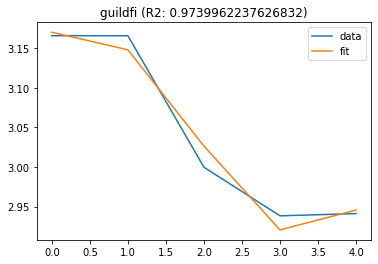

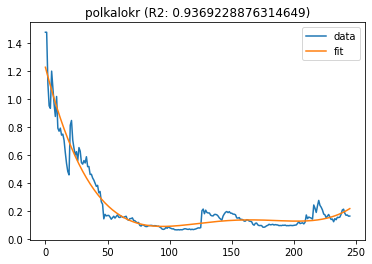

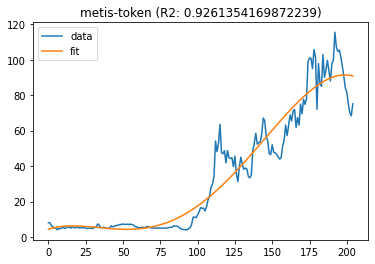

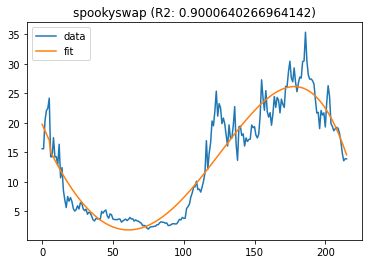

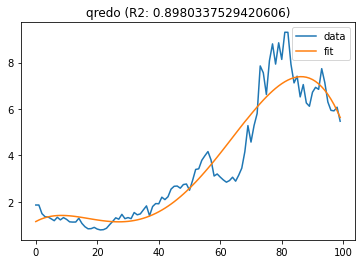

...

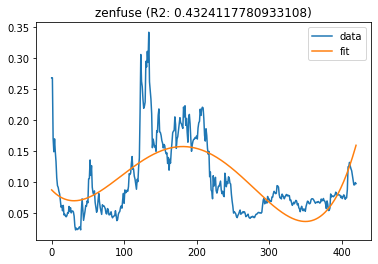

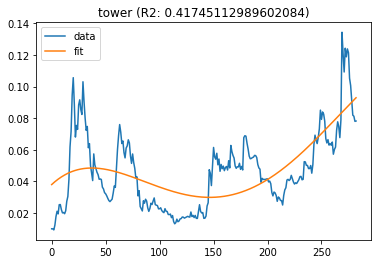

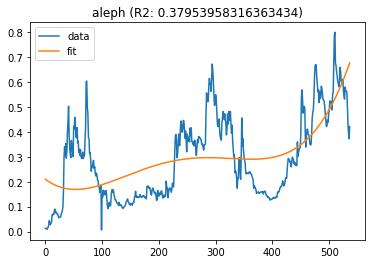

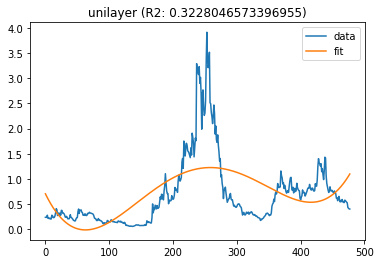

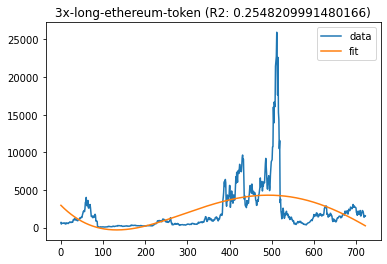

In [176]:
for pr in polyres_df.to_dict('records'):
    tdf=df_prices[df_prices.coin_id == pr['coin']]
    x=dates.date2num(tdf.time)
    poly=np.polyfit(x, tdf.prices, pr['degrees'])
    

    fig, ax = plt.subplots()
    ax.plot(tdf.prices, label='data')
    ax.plot(np.polyval(poly, x), label='fit')
    #ax.set_xticklabels(tdf.time)
    ax.legend()
    ax.set_title(pr['coin']+' (R2: '+str( pr['r2'])+')')


In [110]:
 slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(df_eth['prices'].rolling(3).mean().dropna(), df_eth.prices.tolist()[2:])

In [109]:
len(df_eth.prices.tolist()[2:])
len(df_eth['prices'].rolling(3).mean().dropna())

2313

In [158]:
coin_list=list(set(df_prices.coin_id.unique().tolist()).intersection(set(df_coins.symbol)))
coin_list=df_prices.coin_id.unique().tolist()

res=[]

for coin in coin_list:
    tdf=df_prices[df_prices.coin_id == coin]
    for i in range(2,6):

        sma=tdf.prices.rolling(i).mean().dropna()

        slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(sma, tdf.prices.tolist()[i-1:])
        res.append({'coin':coin,'window':i,'r2':r_value**2})


/home/tyang/.pyenv/versions/3.8.12/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:170: RuntimeWarning:

invalid value encountered in double_scalars

/home/tyang/.pyenv/versions/3.8.12/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:184: RuntimeWarning:

invalid value encountered in sqrt

/home/tyang/.pyenv/versions/3.8.12/lib/python3.8/site-packages/scipy/stats/_stats_mstats_common.py:187: RuntimeWarning:

invalid value encountered in double_scalars



In [161]:
res_df=pd.DataFrame(res).sort_values('r2',ascending=False)
res_df=res_df[res_df.r2==res_df.groupby('coin')['r2'].transform(max)]

/tmp/ipykernel_28079/977368768.py:5: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



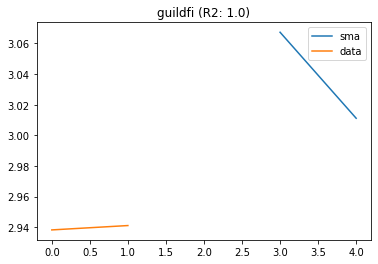

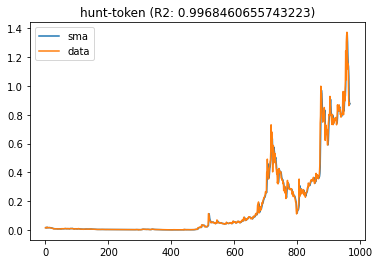

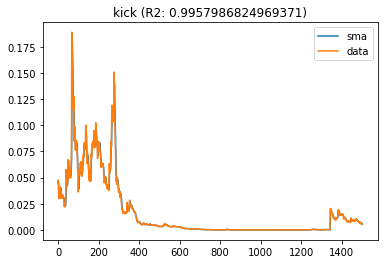

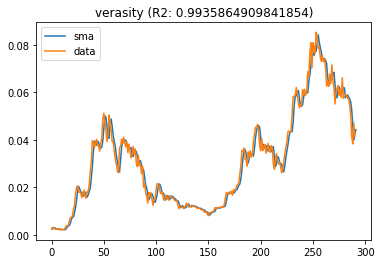

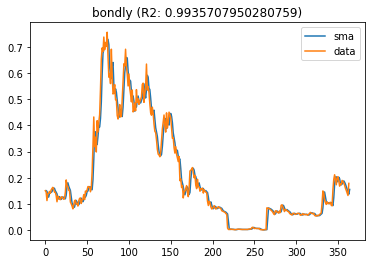

...

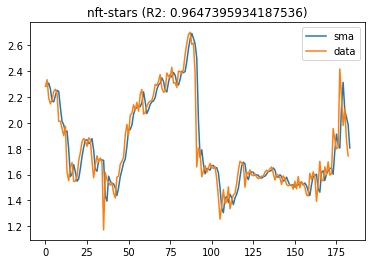

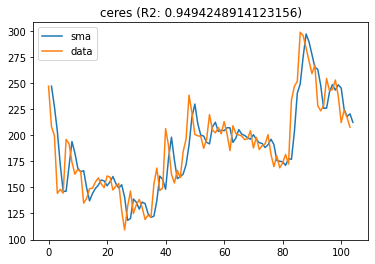

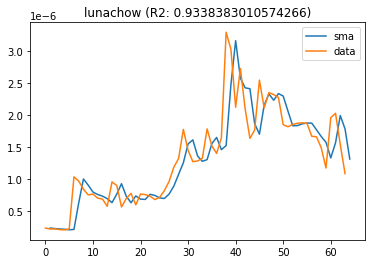

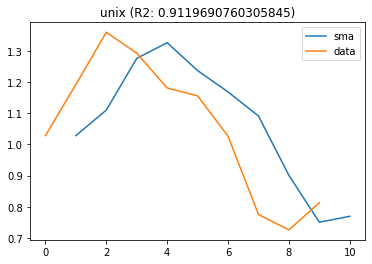

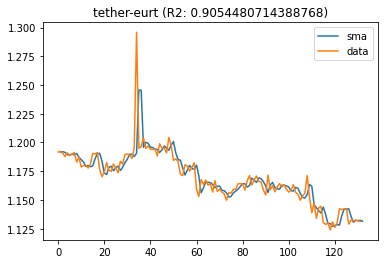

In [177]:
for pr in res_df.to_dict('records'):
    tdf=df_prices[df_prices.coin_id == pr['coin']]
    sma=tdf.prices.rolling(pr['window']).mean().dropna()

    fig, ax = plt.subplots()
    ax.plot(sma, label='sma')
    ax.plot(tdf.prices.tolist()[pr['window']-1:], label='data')
    #ax.set_xticklabels(tdf.time)
    ax.legend()
    ax.set_title(pr['coin']+' (R2: '+str( pr['r2'])+')')
